## Library setup

In [38]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.graph_objects as go
import re
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Dense, LSTM, Embedding, add
from tensorflow.keras.layers import Flatten, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from sklearn.model_selection import train_test_split
from nltk.translate.bleu_score import corpus_bleu
from PIL import Image
from tqdm import tqdm_notebook
from collections import Counter

# Data and Pre-processing

In [39]:
images_directory = '/kaggle/input/flickr8k/Images/'
captions_path = '/kaggle/input/flickr8k/captions.txt'

In [40]:
def load_captions(file_path):
    with open(file_path, 'r') as f:
        captions = f.readlines()
        captions = [caption.lower() for caption in captions[1:]]
    return captions

def tokenize_captions(captions):
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(captions)
    return tokenizer


captions = load_captions(captions_path) 
captions[:15:3]

['1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set of stairs in an entry way .\n',
 '1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playhouse .\n',
 '1001773457_577c3a7d70.jpg,a black dog and a tri-colored dog playing with each other on the road .\n',
 '1001773457_577c3a7d70.jpg,two dogs on pavement moving toward each other .\n',
 '1002674143_1b742ab4b8.jpg,a small girl in the grass plays with fingerpaints in front of a white canvas with a rainbow on it .\n']

## Cleaning the captions

In [41]:
def clean_text(text):
    text = re.sub(r'[^\w\s]', '', text)
    
    text = re.sub(r'\d+', '', text)
    
    text = re.sub(r'\s+', ' ', text).strip()
    
    return text

cleaned_captions = [clean_text(caption.split(',')[1]) for caption in captions]
cleaned_captions[:15:2]

['a child in a pink dress is climbing up a set of stairs in an entry way',
 'a little girl climbing into a wooden playhouse',
 'a little girl in a pink dress going into a wooden cabin',
 'a black dog and a tricolored dog playing with each other on the road',
 'two dogs of different breeds looking at each other on the road',
 'a little girl covered in paint sits in front of a painted rainbow with her hands in a bowl',
 'a small girl in the grass plays with fingerpaints in front of a white canvas with a rainbow on it',
 'young girl with pigtails painting outside in the grass']

In [42]:
captions_IDs = []
for i in range(len(cleaned_captions)):
    item = captions[i].split(',')[0]+'\t'+'start '+cleaned_captions[i]+' end\n'
    captions_IDs.append(item)
    
captions_IDs[:20:3], len(captions_IDs)

(['1000268201_693b08cb0e.jpg\tstart a child in a pink dress is climbing up a set of stairs in an entry way end\n',
  '1000268201_693b08cb0e.jpg\tstart a little girl climbing the stairs to her playhouse end\n',
  '1001773457_577c3a7d70.jpg\tstart a black dog and a tricolored dog playing with each other on the road end\n',
  '1001773457_577c3a7d70.jpg\tstart two dogs on pavement moving toward each other end\n',
  '1002674143_1b742ab4b8.jpg\tstart a small girl in the grass plays with fingerpaints in front of a white canvas with a rainbow on it end\n',
  '1003163366_44323f5815.jpg\tstart a man lays on a bench while his dog sits by him end\n',
  '1003163366_44323f5815.jpg\tstart a shirtless man lies on a park bench with his dog end\n'],
 40455)

## Visualizing some of the images along with their corresponding captions

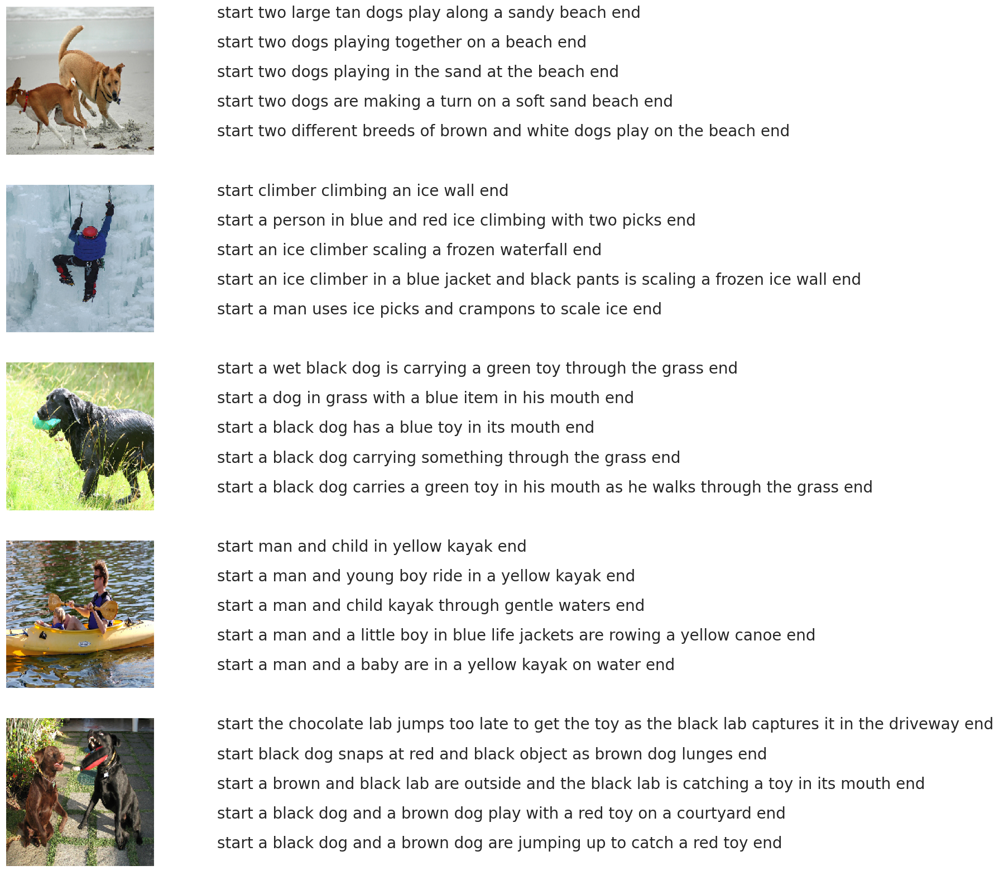

In [43]:
def visualaization(data, num_of_images):
    captions_dictionary = {}
    for item in data[100:100+(num_of_images)*5]:
        image_id, caption = item.split('\t')
        if image_id not in captions_dictionary:
            captions_dictionary[image_id] = []
        captions_dictionary[image_id].append(caption)
    else:
        list_captions = [x for x in captions_dictionary.items()]
    
    count = 1
    fig = plt.figure(figsize=(10,20))
    for filename in list(captions_dictionary.keys()):
        captions = captions_dictionary[filename]
        image_load = load_img(images_directory+filename, target_size=(199,199,3))

        ax = fig.add_subplot(num_of_images,2,count,xticks=[],yticks=[])
        ax.imshow(image_load)
        count += 1

        ax = fig.add_subplot(num_of_images,2,count)
        plt.axis('off')
        ax.plot()
        ax.set_xlim(0,1)
        ax.set_ylim(0,len(captions))
        for i, caption in enumerate(captions):
            ax.text(0,i,caption,fontsize=20)
        count += 1
    plt.show()
    
visualaization(captions_IDs, 5)

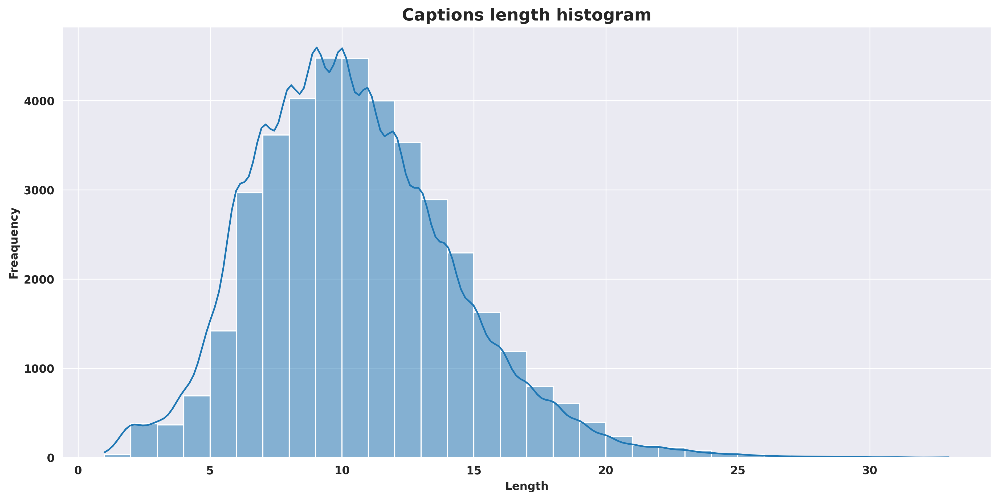

In [44]:
def captions_length(data):
    plt.figure(figsize=(15, 7), dpi=300)
    sns.set_style('darkgrid')
    sns.histplot(x=[len(x.split(' ')) for x in data], kde=True, binwidth=1) 
    plt.title('Captions length histogram', fontsize=15, fontweight='bold')
    plt.xticks(fontweight='bold')
    plt.yticks(fontweight='bold')
    plt.xlabel('Length', fontweight='bold')
    plt.ylabel('Freaquency', fontweight='bold')
    plt.show()
    
captions_length(cleaned_captions)

In [45]:
def word_occurrences(data):
    all_text = ' '.join(data)
    word_counts = Counter(all_text.split())

    words = list(word_counts.keys())[1:30]
    values = list(word_counts.values())[1:30]

    normalized_values = np.array(values) / np.max(values)       
    colors = np.array(['rgba(30, 58, 138, {})'.format(0.4 + 0.5 * (value)) for value in normalized_values])

    fig = go.Figure(data=[go.Pie(labels=words, values=values, hole=.6, marker=dict(colors=colors), textinfo='label')])

    fig.update_layout(title_text='Word occurrences in captions (except for letter \'a\')', title_font=dict(size=23, family='Balto'))

    fig.show()
    
word_occurrences(cleaned_captions)

### **Tokenizing** captions and setting **vocab size**

In [46]:
tokenizer = tokenize_captions(cleaned_captions) #creating word to index mapping
vocab_size = len(tokenizer.word_index) + 1
vocab_size

8586

### Splitting the data into tain, validation and test sets

In [47]:
all_image_ids = os.listdir(images_directory)

train_image_ids, val_image_ids = train_test_split(all_image_ids, test_size=0.15, random_state=42)
val_image_ids, test_image_ids = train_test_split(val_image_ids, test_size=0.1, random_state=42)

train_captions, val_captions, test_captions = [], [], []
for caption in captions_IDs:
    image_id, _ = caption.split('\t')
    
    if image_id in train_image_ids:
        train_captions.append(caption)
        
    elif image_id in val_image_ids:
        val_captions.append(caption)        

    elif image_id in test_image_ids:
        test_captions.append(caption)
        
    else:
        print('Unknown image ID !')

train_captions[0], val_captions[0], test_captions[0], len(train_captions)/5, len(val_captions)/5, len(test_captions)/5

('1000268201_693b08cb0e.jpg\tstart a child in a pink dress is climbing up a set of stairs in an entry way end\n',
 '1001773457_577c3a7d70.jpg\tstart a black dog and a spotted dog are fighting end\n',
 '1042590306_95dea0916c.jpg\tstart a man and woman pose for the camera while another man looks on end\n',
 6877.0,
 1092.0,
 122.0)

## **Extracting Image features** using **The InceptionV3** model

In [48]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(299, 299))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.inception_v3.preprocess_input(img)
    return img

def extract_image_features(model, image_path):
    img = preprocess_image(image_path)
    features = model.predict(img, verbose=0)
    return features

inception_v3_model = InceptionV3(weights = 'imagenet', input_shape=(299, 299, 3))
inception_v3_model.layers.pop()
inception_v3_model = Model(inputs=inception_v3_model.inputs, outputs=inception_v3_model.layers[-2].output)

In [49]:
train_image_features, val_image_features, test_image_features = {}, {}, {}  

pbar = tqdm_notebook(total=len(all_image_ids), position=0, leave=True, colour='green') 

for caption in all_image_ids:
    image_id = caption.split('\t')[0]
    image_path = os.path.join(images_directory, image_id)
    image_features = extract_image_features(inception_v3_model, image_path) 
    
    if image_id in train_image_ids:
        train_image_features[image_id] = image_features.flatten()  
        pbar.update(1)
    
    elif image_id in val_image_ids:
        val_image_features[image_id] = image_features.flatten()  
        pbar.update(1)
    
    elif image_id in test_image_ids:
        test_image_features[image_id] = image_features.flatten()  
        pbar.update(1)
    
    else:
        print('Unknown image ID !')
    
pbar.close()

  0%|          | 0/8091 [00:00<?, ?it/s]

# **Data Setup for Model Input**


In [50]:
def data_generator(captions, image_features, tokenizer, max_caption_length, batch_size):
    num_samples = len(captions)
    image_ids = list(image_features.keys())
    while True:
        np.random.shuffle(image_ids)  
        for start_idx in range(0, num_samples, batch_size):
            end_idx = min(start_idx + batch_size, num_samples)
            X_images, X_captions, y = [], [], []
            for caption in captions[start_idx:end_idx]:
                image_id, caption_text = caption.split('\t')
                caption_text = caption_text.rstrip('\n')
                seq = tokenizer.texts_to_sequences([caption_text])[0] 
                for i in range(1, len(seq)):
                    in_seq, out_seq = seq[:i], seq[i] 
                    in_seq = pad_sequences([in_seq], maxlen=max_caption_length)[0]
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    X_images.append(image_features[image_id])
                    X_captions.append(in_seq)
                    y.append(out_seq)
            
            yield [np.array(X_images), np.array(X_captions)], np.array(y)
         
        
max_caption_length = max(len(caption.split()) for caption in cleaned_captions) + 1

cnn_output_dim = inception_v3_model.output_shape[1] 

batch_size_train = 270
batch_size_val = 150

train_data_generator = data_generator(train_captions, train_image_features, tokenizer, max_caption_length, batch_size_train)
val_data_generator = data_generator(val_captions, val_image_features, tokenizer, max_caption_length, batch_size_val)

In [51]:
sample_batch = next(train_data_generator)
print("Training sample batch shapes:")
print("X_images:", sample_batch[0][0].shape)
print("X_captions:", sample_batch[0][1].shape)
print("y:", sample_batch[1].shape)
print('=========================')
sample_batch = next(val_data_generator)
print("Validation sample batch shapes:")
print("X_images:", sample_batch[0][0].shape)
print("X_captions:", sample_batch[0][1].shape)
print("y:", sample_batch[1].shape)

Training sample batch shapes:
X_images: (3230, 2048)
X_captions: (3230, 34)
y: (3230, 8586)
Validation sample batch shapes:
X_images: (1676, 2048)
X_captions: (1676, 34)
y: (1676, 8586)


# **Defining** the **Image Captioning** Model

 ### **Encoder** 
 * Input Layer
 * Batch Normalization Layer
 * Dense Layer
 * Batch Normalization Layer

 ### **Decoder** 
 * Input Layer
 * Embedding Layer
 * **LSTM** Layer

 ### **Output**
 * Add Layer (Encoder output + Decoder output)
 * Dense Layer + ReLU activation function
 * Dense Layer + Softmax activation function

In [52]:
def build_model(vocab_size, max_caption_length, cnn_output_dim):
    # Encoder Model
    input_image = Input(shape=(cnn_output_dim,), name='Features_Input')
    fe1 = BatchNormalization()(input_image)
    fe2 = Dense(256, activation='relu')(fe1) 
    fe3 = BatchNormalization()(fe2)
    
    # Decoder Model
    input_caption = Input(shape=(max_caption_length,), name='Sequence_Input')
    se1 = Embedding(vocab_size, 256, mask_zero=True)(input_caption)
    se2 = LSTM(256)(se1)
    
    # Output
    decoder1 = add([fe3, se2])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax', name='Output_Layer')(decoder2)

    model = Model(inputs=[input_image, input_caption], outputs=outputs, name='Image_Captioning')
    return model
    
caption_model = build_model(vocab_size, max_caption_length, cnn_output_dim)

optimizer = Adam(learning_rate=0.01, clipnorm=1.0)
caption_model.compile(loss='categorical_crossentropy', optimizer=optimizer)

caption_model.summary()

Model: "Image_Captioning"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Features_Input (InputLayer)    [(None, 2048)]       0           []                               
                                                                                                  
 batch_normalization_284 (Batch  (None, 2048)        8192        ['Features_Input[0][0]']         
 Normalization)                                                                                   
                                                                                                  
 Sequence_Input (InputLayer)    [(None, 34)]         0           []                               
                                                                                                  
 dense_2 (Dense)                (None, 256)          524544      ['batch_normalizat

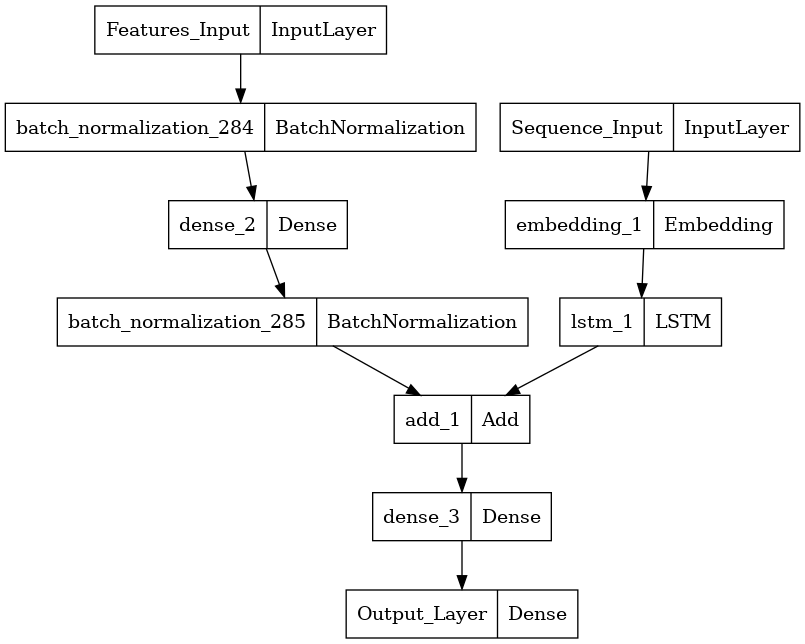

In [53]:
plot_model(caption_model)

# Training the model


In [54]:
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

def lr_scheduler(epoch, lr):
    return lr * tf.math.exp(-0.6)

lr_schedule = LearningRateScheduler(lr_scheduler)

history = caption_model.fit(train_data_generator, steps_per_epoch=len(train_captions) // batch_size_train,
                        validation_data=val_data_generator, validation_steps=len(val_captions) // batch_size_val,
                        epochs=15, callbacks=[early_stopping, lr_schedule])

Epoch 1/15
127/127 [==============================] - 55s 385ms/step - loss: 4.5469 - val_loss: 3.7839 - lr: 0.0055
Epoch 2/15
127/127 [==============================] - 46s 359ms/step - loss: 3.3024 - val_loss: 3.3834 - lr: 0.0030
Epoch 3/15
127/127 [==============================] - 46s 362ms/step - loss: 2.9134 - val_loss: 3.2691 - lr: 0.0017
Epoch 4/15
127/127 [==============================] - 46s 364ms/step - loss: 2.6995 - val_loss: 3.2360 - lr: 9.0718e-04
Epoch 5/15
127/127 [==============================] - 46s 361ms/step - loss: 2.5646 - val_loss: 3.2277 - lr: 4.9787e-04
Epoch 6/15
127/127 [==============================] - 46s 363ms/step - loss: 2.4831 - val_loss: 3.2264 - lr: 2.7324e-04
Epoch 7/15
127/127 [==============================] - 46s 361ms/step - loss: 2.4335 - val_loss: 3.2285 - lr: 1.4996e-04
Epoch 8/15
127/127 [==============================] - 46s 362ms/step - loss: 2.4058 - val_loss: 3.2328 - lr: 8.2297e-05
Epoch 9/15
127/127 [==============================] 

### Visualizing the model performance

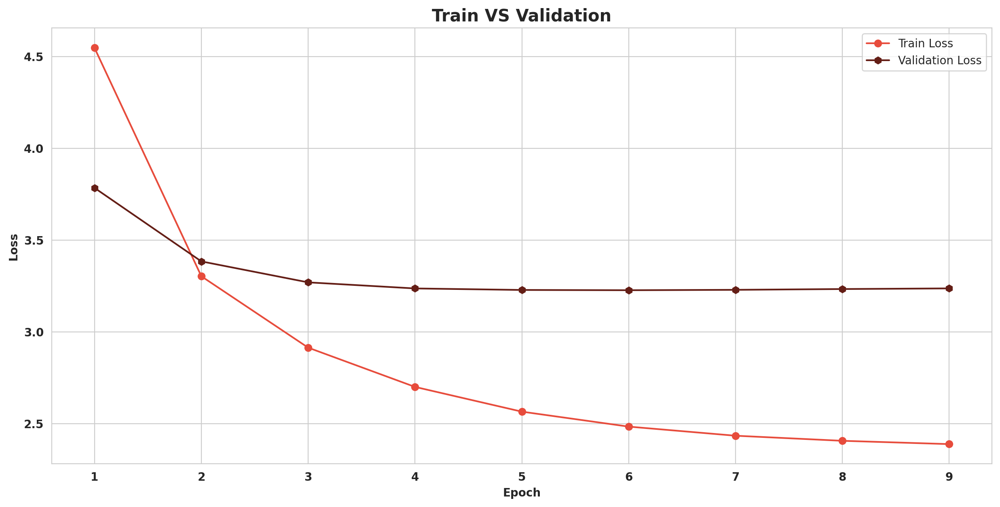

In [55]:
plt.figure(figsize=(15, 7), dpi=200)
sns.set_style('whitegrid')
plt.plot([x+1 for x in range(len(history.history['loss']))], history.history['loss'], color='#E74C3C', marker='o')
plt.plot([x+1 for x in range(len(history.history['loss']))], history.history['val_loss'], color='#641E16', marker='h')
plt.title('Train VS Validation', fontsize=15, fontweight='bold')
plt.xticks(fontweight='bold')
plt.yticks(fontweight='bold')
plt.xlabel('Epoch', fontweight='bold')
plt.ylabel('Loss', fontweight='bold')
plt.legend(['Train Loss', 'Validation Loss'], loc='best')
plt.show()

In [56]:
def greedy_generator(image_features): 
    in_text = 'start '
    for _ in range(max_caption_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_caption_length).reshape((1,max_caption_length))
        prediction = caption_model.predict([image_features.reshape(1,cnn_output_dim), sequence], verbose=0)
        idx = np.argmax(prediction)
        word = tokenizer.index_word[idx]
        in_text += ' ' + word
        if word == 'end':
            break
            
    in_text = in_text.replace('start ', '')
    in_text = in_text.replace(' end', '')
    
    return in_text

In [57]:
def BLEU_score(actual, greedy, beam_search):
    score_greedy_1 = corpus_bleu(actual, greedy, weights=(0.3, 0.3, 0.3, 0))
    score_greedy_2 = corpus_bleu(actual, greedy, weights=(0.25, 0.25, 0.25, 0.25))
    score_BS_1 = corpus_bleu(actual, beam_search, weights=(0.3, 0.3, 0.3, 0))
    score_BS_2 = corpus_bleu(actual, beam_search, weights=(0.25, 0.25, 0.25, 0.25))
    
    return [
        (f'BLEU-2 Greedy: {round(score_BS_2, 5)}'),
        (f'BLEU-1 Greedy: {round(score_BS_1, 5)}'),
        (f'Greedy: {greedy[0]}'),
        (f'BLEU-2 Beam Search: {round(score_greedy_2, 5)}'),
        (f'BLEU-1 Beam Search: {round(score_greedy_1, 5)}'),
        (f'Beam Search:  {beam_search[0]}')
    ]

In [58]:
def beam_search_generator(image_features, K_beams = 3, log = False):
    start = [tokenizer.word_index['start']]
    
    start_word = [[start, 0.0]]
    
    for _ in range(max_caption_length):
        temp = []
        for s in start_word:
            # Sequence of most probable words based on the previous steps
            sequence  = pad_sequences([s[0]], maxlen=max_caption_length).reshape((1,max_caption_length))
            
            preds = caption_model.predict([image_features.reshape(1,cnn_output_dim), sequence], verbose=0)
            
            # Sorting predictions by the probability and taking the last K_beams items.
            word_preds = np.argsort(preds[0])[-K_beams:]
            
            # Getting the top <K_beams>(n) predictions and creating a 
            #                              new list so as to put them via the model again.
            for w in word_preds:
                
                next_cap, prob = s[0][:], s[1]
                next_cap.append(w)
                if log:
                    prob += np.log(preds[0][w]) # assign a probability to each K words
                else:
                    prob += preds[0][w]
                temp.append([next_cap, prob])
                
        start_word = temp
        start_word = sorted(start_word, reverse=False, key=lambda l: l[1])

        start_word = start_word[-K_beams:]
    
    start_word = start_word[-1][0]
    captions_ = [tokenizer.index_word[i] for i in start_word]

    final_caption = []
    
    for i in captions_:
        if i != 'end':
            final_caption.append(i)
        else:
            break
    
    final_caption = ' '.join(final_caption[1:])
    return final_caption

In [59]:
test_actual_captions = {}
for item in test_captions:
    image_id, caption = item.split('\t')
    if image_id not in test_actual_captions:
        test_actual_captions[image_id] = []
    test_actual_captions[image_id].append(caption)

In [60]:
generated_captions = {}

pbar = tqdm_notebook(total=len(test_image_features), position=0, leave=True, colour='green')
for image_id in test_image_features:
    cap = greedy_generator(test_image_features[image_id])
    generated_captions[image_id] = cap
    pbar.update(1)
    
pbar.close()

  0%|          | 0/122 [00:00<?, ?it/s]

## Visualizing some of the **test images** along with their corresponding **generated captions**

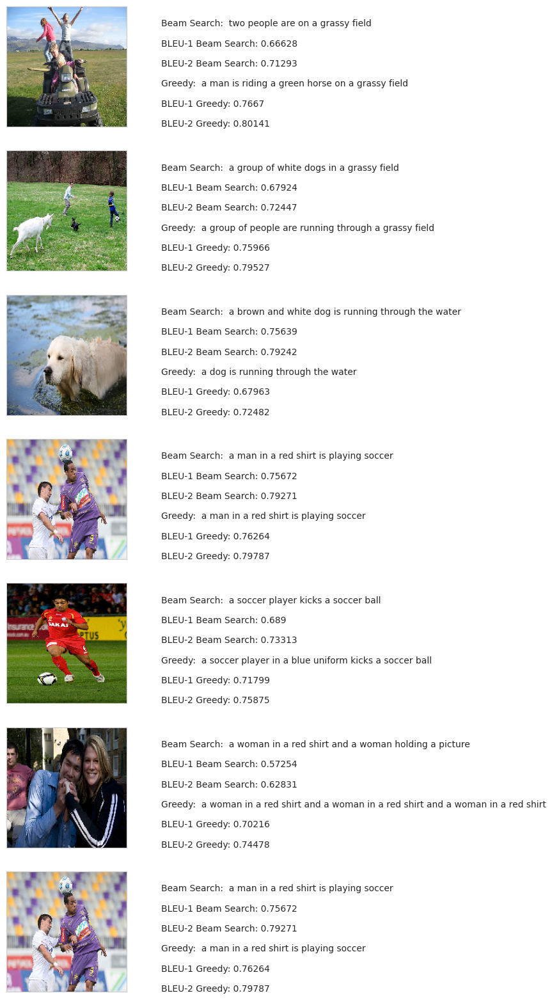

In [61]:
def visualization(data, greedy_caps, beamS_generator, evaluator, num_of_images):
    keys = list(data.keys()) 
    images = [np.random.choice(keys) for i in range(num_of_images)] 
    
    count = 1
    fig = plt.figure(figsize=(6,20))    
    for filename in images:
        actual_cap = data[filename]
        actual_cap = [x.replace("start ", "") for x in actual_cap] 
        actual_cap = [x.replace(" end", "") for x in actual_cap] 
    
        greedy_cap = greedy_caps[filename]
        beamS_cap = beamS_generator(test_image_features[filename])
        
        caps_with_score = evaluator(actual_cap, [greedy_cap]*(len(actual_cap)), [beamS_cap]*(len(actual_cap)))
    
        image_load = load_img(images_directory+filename, target_size=(199,199,3))
        ax = fig.add_subplot(num_of_images,2,count,xticks=[],yticks=[])
        ax.imshow(image_load)
        count += 1

        ax = fig.add_subplot(num_of_images,2,count)
        plt.axis('off')
        ax.plot()
        ax.set_xlim(0,1)
        ax.set_ylim(0,len(caps_with_score))
        for i, text in enumerate(caps_with_score):
            ax.text(0,i,text,fontsize=10)
        count += 1
    plt.show()

visualization(test_actual_captions, generated_captions, beam_search_generator, BLEU_score, 7)

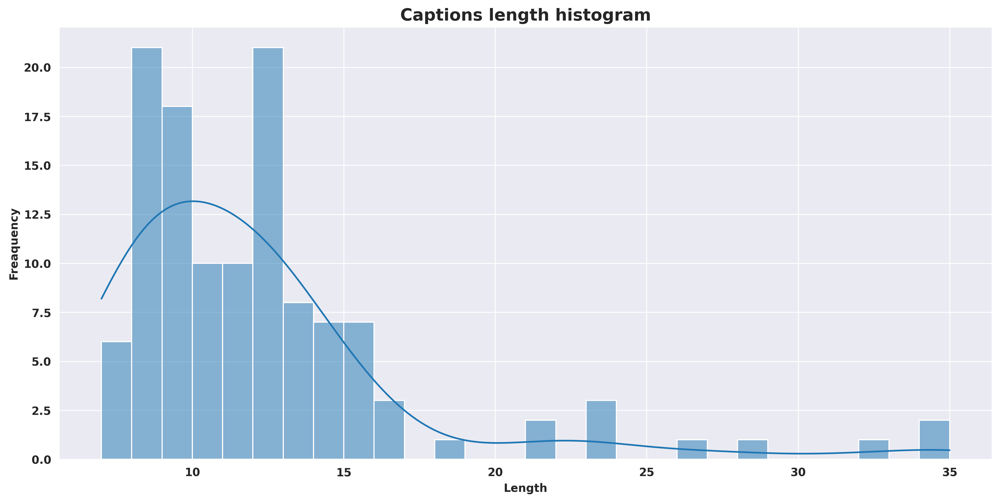

In [62]:
captions_length(list(generated_captions.values()))

In [63]:
word_occurrences(list(generated_captions.values()))

In [64]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import numpy as np
from tqdm.notebook import tqdm

def calculate_bleu_scores(actual_captions, generated_captions):
    smoothing = SmoothingFunction().method1
    bleu_scores = []
    
    pbar = tqdm(total=len(actual_captions), desc="Calculating BLEU Scores", position=0, leave=True)
    
    for image_id in actual_captions:
        references = [cap.split() for cap in actual_captions[image_id]]
        hypothesis = generated_captions[image_id].split()
        
        
        score_bleu1 = sentence_bleu(references, hypothesis, weights=(1, 0, 0, 0), smoothing_function=smoothing)
        
        score_bleu2 = sentence_bleu(references, hypothesis, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing)
        
        score_bleu3 = sentence_bleu(references, hypothesis, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing)
        score_bleu4 = sentence_bleu(references, hypothesis, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing)
        
        bleu_scores.append((score_bleu1, score_bleu2, score_bleu3, score_bleu4))
        
        pbar.update(1)
    

    pbar.close()
    
    return bleu_scores

greedy_captions = {}
beam_search_captions = {}

for image_id in test_image_features:
    greedy_captions[image_id] = greedy_generator(test_image_features[image_id])
    beam_search_captions[image_id] = beam_search_generator(test_image_features[image_id])

    
greedy_bleu_scores = calculate_bleu_scores(test_actual_captions, greedy_captions)
beam_search_bleu_scores = calculate_bleu_scores(test_actual_captions, beam_search_captions)


def average_bleu_scores(bleu_scores):
    avg_bleu1 = np.mean([score[0] for score in bleu_scores])
    avg_bleu2 = np.mean([score[1] for score in bleu_scores])
    avg_bleu3 = np.mean([score[2] for score in bleu_scores])
    avg_bleu4 = np.mean([score[3] for score in bleu_scores])
    
    return avg_bleu1, avg_bleu2, avg_bleu3, avg_bleu4

avg_greedy_bleu = average_bleu_scores(greedy_bleu_scores)
avg_beam_search_bleu = average_bleu_scores(beam_search_bleu_scores)


print(f"Greedy Search Average BLEU Scores:")
print(f"BLEU-1: {avg_greedy_bleu[0]:.4f}, BLEU-2: {avg_greedy_bleu[1]:.4f}, BLEU-3: {avg_greedy_bleu[2]:.4f}, BLEU-4: {avg_greedy_bleu[3]:.4f}\n")

print(f"Beam Search Average BLEU Scores:")
print(f"BLEU-1: {avg_beam_search_bleu[0]:.4f}, BLEU-2: {avg_beam_search_bleu[1]:.4f}, BLEU-3: {avg_beam_search_bleu[2]:.4f}, BLEU-4: {avg_beam_search_bleu[3]:.4f}")


Calculating BLEU Scores:   0%|          | 0/122 [00:00<?, ?it/s]

Calculating BLEU Scores:   0%|          | 0/122 [00:00<?, ?it/s]

Greedy Search Average BLEU Scores:
BLEU-1: 0.5465, BLEU-2: 0.3709, BLEU-3: 0.2228, BLEU-4: 0.1375

Beam Search Average BLEU Scores:
BLEU-1: 0.5456, BLEU-2: 0.3629, BLEU-3: 0.2220, BLEU-4: 0.1354


In [65]:
import cv2
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K


In [66]:
# List all layers of the model
for layer in inception_v3_model.layers:
    print(layer.name, layer.output_shape)


input_3 [(None, 299, 299, 3)]
conv2d_188 (None, 149, 149, 32)
batch_normalization_190 (None, 149, 149, 32)
activation_188 (None, 149, 149, 32)
conv2d_189 (None, 147, 147, 32)
batch_normalization_191 (None, 147, 147, 32)
activation_189 (None, 147, 147, 32)
conv2d_190 (None, 147, 147, 64)
batch_normalization_192 (None, 147, 147, 64)
activation_190 (None, 147, 147, 64)
max_pooling2d_8 (None, 73, 73, 64)
conv2d_191 (None, 73, 73, 80)
batch_normalization_193 (None, 73, 73, 80)
activation_191 (None, 73, 73, 80)
conv2d_192 (None, 71, 71, 192)
batch_normalization_194 (None, 71, 71, 192)
activation_192 (None, 71, 71, 192)
max_pooling2d_9 (None, 35, 35, 192)
conv2d_196 (None, 35, 35, 64)
batch_normalization_198 (None, 35, 35, 64)
activation_196 (None, 35, 35, 64)
conv2d_194 (None, 35, 35, 48)
conv2d_197 (None, 35, 35, 96)
batch_normalization_196 (None, 35, 35, 48)
batch_normalization_199 (None, 35, 35, 96)
activation_194 (None, 35, 35, 48)
activation_197 (None, 35, 35, 96)
average_pooling2d_18 (

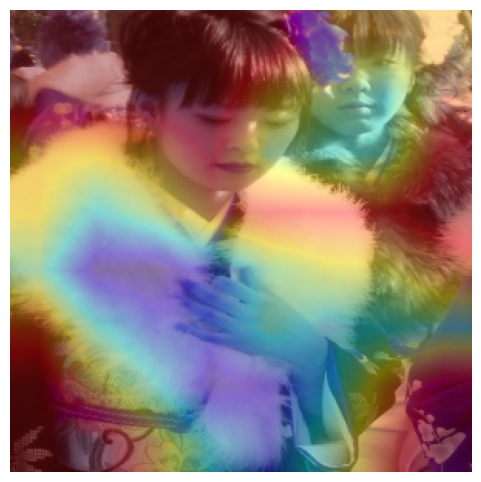

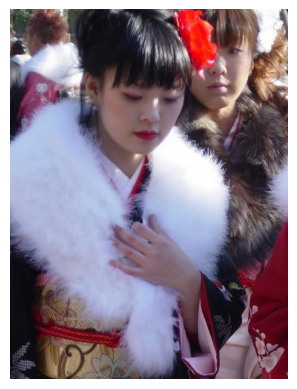

In [67]:

# Additional imports for Grad-CAM
import cv2
from tensorflow.keras import backend as K

# Load the captions and process them (existing code)
# ... (code to load and preprocess captions) ...

# Define the preprocess_image and extract_image_features functions (existing code)
# Preprocess images for Grad-CAM (already done)

# Model Definition (from before)
inception_v3_model = InceptionV3(weights='imagenet', input_shape=(299, 299, 3))
inception_v3_model.layers.pop()  # Remove last layer to get feature maps
inception_v3_model = Model(inputs=inception_v3_model.inputs, outputs=inception_v3_model.layers[-2].output)

# Add the function to compute Grad-CAM
def compute_gradcam(model, img, cnn_layer_name='mixed10', pred_index=None):
    """
    Computes the Grad-CAM for the given model, image, and last CNN layer.

    Args:
    - model: Keras model used for prediction
    - img: The input image
    - cnn_layer_name: Name of the last CNN layer in the model
    - pred_index: Index of the predicted class (optional)
    
    Returns:
    - heatmap: Heatmap for the image
    """
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(cnn_layer_name).output, model.output]
    )
    
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model([img])
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_output = predictions[:, pred_index]
        
    # Get gradients of the class output with respect to the feature map
    grads = tape.gradient(class_output, conv_outputs)

    # Compute the mean of gradients along the axis (spatial dimensions)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Multiply each channel in the feature map array by the mean gradient
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # Normalize the heatmap
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    heatmap = heatmap.numpy()

    return heatmap

# Function to overlay heatmap on image
def overlay_heatmap(heatmap, img_path, alpha=0.4, colormap=cv2.COLORMAP_JET):
    """
    Superimposes the heatmap onto the image.
    
    Args:
    - heatmap: The Grad-CAM heatmap
    - img_path: Path to the original image
    - alpha: Transparency level for the heatmap overlay
    - colormap: Colormap to apply on the heatmap

    Returns:
    - img_with_heatmap: The image with heatmap overlay
    """
    # Load image and resize
    img = cv2.imread(img_path)
    img = cv2.resize(img, (299, 299))

    # Convert heatmap to RGB and apply colormap
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)

    # Combine heatmap with original image
    img_with_heatmap = cv2.addWeighted(img, 1 - alpha, heatmap, alpha, 0)

    return img_with_heatmap

# Function to display Grad-CAM on image
def show_gradcam(image_path, model, cnn_layer_name='mixed10', pred_index=None):
    """
    Displays the Grad-CAM for the given image.
    
    Args:
    - image_path: Path to the input image
    - model: The trained Keras model
    - cnn_layer_name: Name of the last CNN layer in the model
    - pred_index: Index of the predicted class (optional)
    """
    # Preprocess the input image
    img = preprocess_image(image_path)
    
    # Compute Grad-CAM
    heatmap = compute_gradcam(model, img, cnn_layer_name, pred_index)
    
    # Overlay heatmap on original image
    img_with_heatmap = overlay_heatmap(heatmap, image_path)
    
    # Display the image
    plt.figure(figsize=(6,6))
    plt.imshow(img_with_heatmap)
    plt.axis('off')
    plt.show()

# Call the function to visualize Grad-CAM for an image
# Select one image from test set
image_id = list(test_image_features.keys())[0]
image_path = os.path.join(images_directory, image_id)

# Show Grad-CAM
show_gradcam(image_path, inception_v3_model, cnn_layer_name='mixed10')
image = Image.open(image_path)

# Show the image
plt.imshow(image)
plt.axis('off')  # Optional, to hide axes
plt.show()

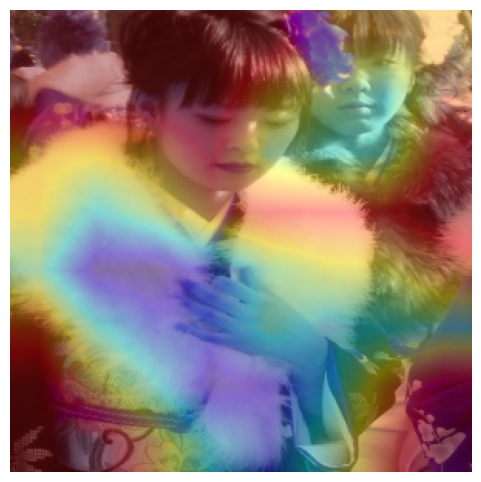

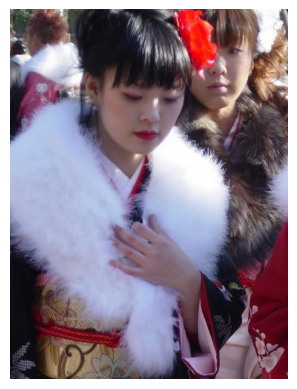

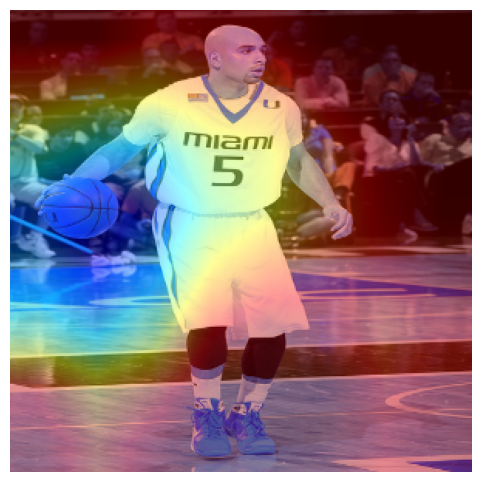

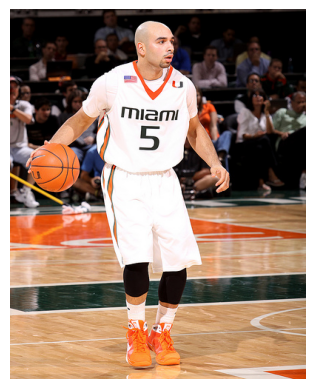

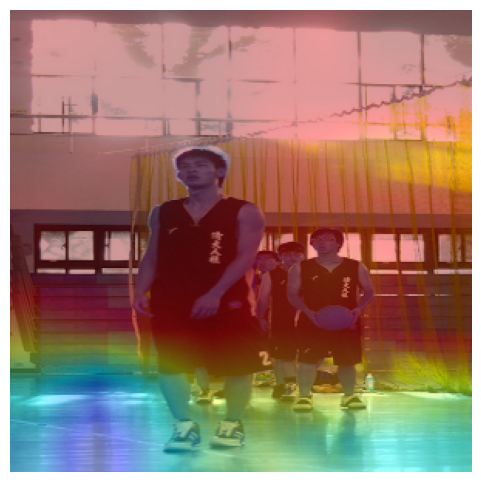

...

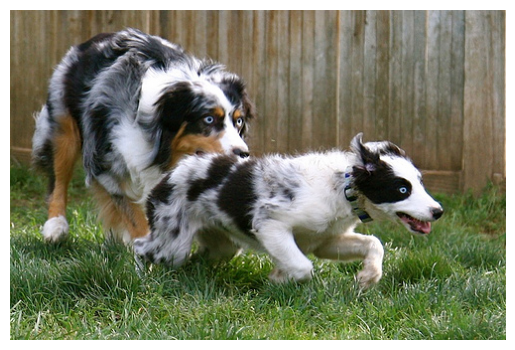

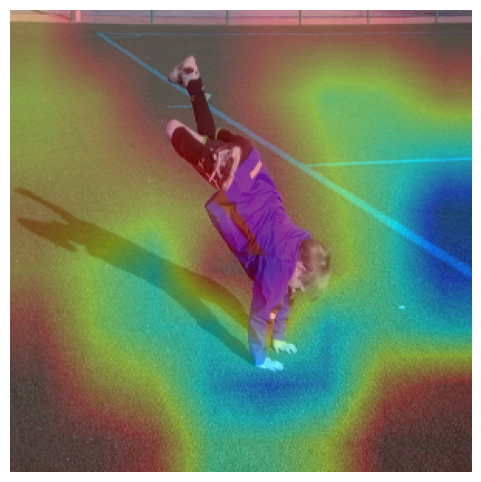

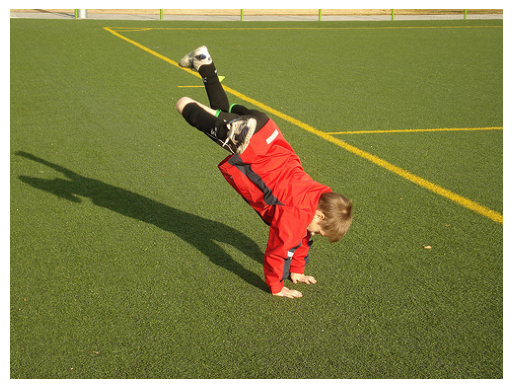

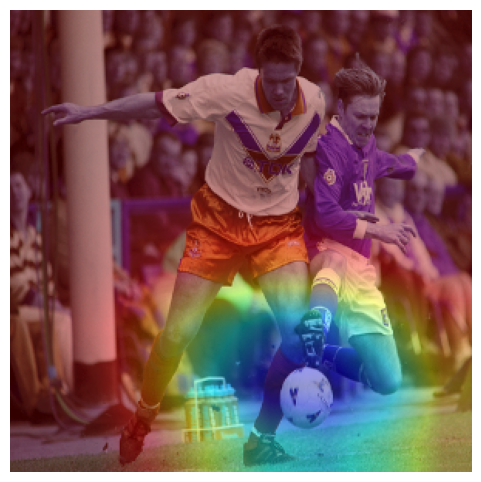

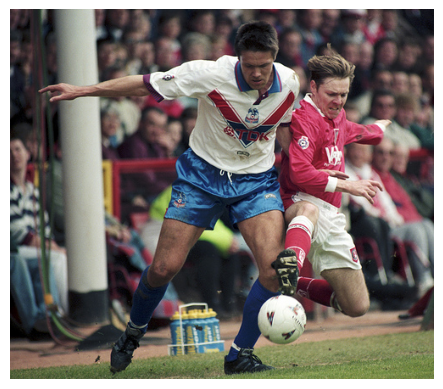

In [69]:
# Loop through all images in test set
#for image_id in test_image_features.keys():
 #   image_path = os.path.join(images_directory, image_id)
  #  
   # # Show Grad-CAM
    #show_gradcam(image_path, inception_v3_model, cnn_layer_name='mixed10')
    #image = Image.open(image_path)
    
    # Show the image
    #plt.imshow(image)
    #plt.axis('off')  # Optional, to hide axes
    #plt.show()
    
    # Convert test_image_features.keys() to a list and slice the first 25 items
for image_id in list(test_image_features.keys())[:25]:
    image_path = os.path.join(images_directory, image_id)
    
    # Show Grad-CAM
    show_gradcam(image_path, inception_v3_model, cnn_layer_name='mixed10')
    image = Image.open(image_path)
    
    # Show the image
    plt.imshow(image)
    plt.axis('off')  # Optional, to hide axes
    plt.show()


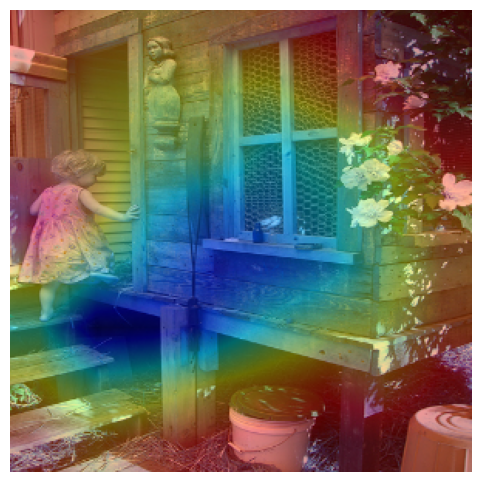

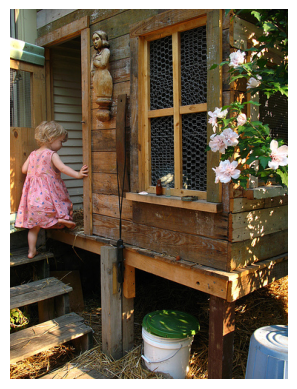

In [71]:
# Select one image from test set
image_id ='/kaggle/input/flickr8k/Images/1000268201_693b08cb0e.jpg'  # Replace'some_other_image_id.jpg' with the ID of the image you want to test
image_path = os.path.join(images_directory, image_id)

# Show Grad-CAM
show_gradcam(image_path, inception_v3_model, cnn_layer_name='mixed10')
image = Image.open(image_path)

# Show the image
plt.imshow(image)
plt.axis('off')  # Optional, to hide axes
plt.show()

In [72]:
def clrde_metric(actual_captions, generated_captions, max_len_penalty=0.3):
    """
    Calculate CLrDE score between actual captions and generated captions.
    
    Parameters:
    - actual_captions: list of ground-truth captions.
    - generated_captions: list of generated captions (e.g., from a model).
    - max_len_penalty: scaling factor to penalize long or short captions.
    
    Returns:
    - A list of CLrDE scores for each image.
    """
    # Average length of actual captions
    avg_length = np.mean([len(caption.split()) for caption in actual_captions])
    
    clrde_scores = []
    
    for gen_caption, act_captions in zip(generated_captions, actual_captions):
        # Step 1: Length Regularization Penalty
        gen_length = len(gen_caption.split())
        length_penalty = 1 - max_len_penalty * abs(gen_length - avg_length) / avg_length
        
        # Step 2: Discriminative Power (based on token overlap with actual captions)
        actual_tokens = set(' '.join(act_captions).split())
        gen_tokens = set(gen_caption.split())
        
        # Overlap ratio: |gen ∩ actual| / |gen ∪ actual|
        overlap_score = len(gen_tokens & actual_tokens) / len(gen_tokens | actual_tokens)
        
        # Step 3: Combine the length regularization and discriminative score
        clrde_score = length_penalty * overlap_score
        
        clrde_scores.append(clrde_score)
    
    return clrde_scores


In [73]:
def clrde_metric(actual_captions, generated_captions, max_len_penalty=0.3):
    """
    Calculate CLrDE score between actual captions and generated captions.

    Args:
    - actual_captions: List of actual captions (list of lists of strings, where each inner list contains captions for one image).
    - generated_captions: List of generated captions (list of strings, one generated caption per image).
    - max_len_penalty: Regularization term that penalizes the length difference between actual and generated captions.

    Returns:
    - A list of CLrDE scores for each image.
    """
    clrde_scores = []

    for gen_caption, act_captions in zip(generated_captions, actual_captions):
        # Step 1: Average length of actual captions
        avg_length = np.mean([len(caption.split()) for caption in act_captions])

        # Step 2: Length Regularization Penalty
        gen_length = len(gen_caption.split())
        length_penalty = max_len_penalty * abs(gen_length - avg_length)

        # Step 3: Diversity and Entropy (placeholder calculation)
        unique_words = set(gen_caption.split())
        diversity_score = len(unique_words) / gen_length if gen_length > 0 else 0

        entropy_score = -np.sum([gen_caption.count(word) / gen_length * np.log(gen_caption.count(word) / gen_length + 1e-8)
                                 for word in unique_words])

        # Step 4: Combined CLrDE score
        clrde_score = diversity_score + entropy_score - length_penalty
        clrde_scores.append(clrde_score)

    return clrde_scores

# List to hold CLrDE scores for generated captions
generated_clrde_scores = []

# Iterate over the test images and calculate CLrDE scores
for image_id in test_image_features:
    actual_captions = test_actual_captions[image_id]
    gen_caption = generated_captions[image_id]

    # Calculate CLrDE score for this image
    clrde_score = clrde_metric([actual_captions], [gen_caption])
    generated_clrde_scores.append(clrde_score[0])

# Output the CLrDE scores
print("CLrDE Scores:", generated_clrde_scores)


CLrDE Scores: [2.8168546976182522, -0.24442534562840246, 3.3905291471620336, 2.4544046492114733, 1.8302062723483128, 2.421924159161765, 1.951329280794501, 2.7982835845792566, 1.9458551916175184, 1.9720806794340129, -0.1626592093534731, -4.088090463077384, 2.9637517627764733, 2.528648760603673, 2.465843139368881, 2.6287095962645566, 1.1858003041797214, 1.6068590681454673, -0.5697937276516876, 2.5284030558424178, 2.972520548178745, 0.7817930636295909, 2.7188427764443075, 2.8629033919595033, 0.4259598836997678, 1.5035594311898606, 1.8393369272460842, 2.9260848592498316, 1.641154676539852, 0.6173407906465267, 1.7702062723483123, 2.8660918852891655, 2.1255016100437256, 0.7937690703187412, 2.3754085236570317, 3.184886760274473, 2.303731985901944, -0.18595630762525817, 1.807322238849257, 2.5646888114079442, 2.6473222388492568, 0.8841117101639173, 0.9250108946096163, 1.6458551916175184, 2.1088908369841954, 2.8982546873576536, 1.5955231504333585, 1.2850108946096161, 2.860495272200761, -2.534339

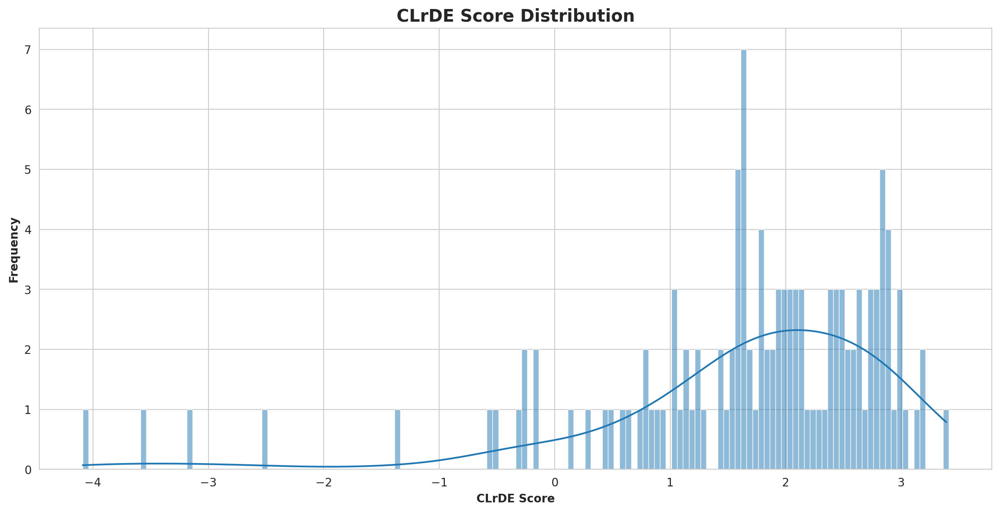

In [74]:
def visualize_clrde_scores(clrde_scores):
    plt.figure(figsize=(15, 7), dpi=200)
    sns.set_style('whitegrid')
    sns.histplot(clrde_scores, kde=True, binwidth=0.05)
    plt.title('CLrDE Score Distribution', fontsize=15, fontweight='bold')
    plt.xlabel('CLrDE Score', fontweight='bold')
    plt.ylabel('Frequency', fontweight='bold')
    plt.show()

# Visualize the CLrDE scores for the generated captions
visualize_clrde_scores(generated_clrde_scores)


In [75]:
    !pip install rouge-score


  Preparing metadata (setup.py) ... done
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=24934 sha256=370175fd6b7de8a58cfe034656742e72ca2ee14f2b8e2984061b0d09fd0354b2
  Stored in directory: /root/.cache/pip/wheels/5f/dd/89/461065a73be61a532ff8599a28e9beef17985c9e9c31e541b4
Successfully built rouge-score


Average ROUGE Scores across all test images:
{'rouge-1': {'f': 0.28656902376102805, 'p': 0.3377495910282796, 'r': 0.2646697463247828}, 'rouge-2': {'f': 0.08046081276878361, 'p': 0.08911457167604699, 'r': 0.07983078515215701}, 'rouge-l': {'f': 0.26071117475687494, 'p': 0.3057005289792174, 'r': 0.2417577370470304}}


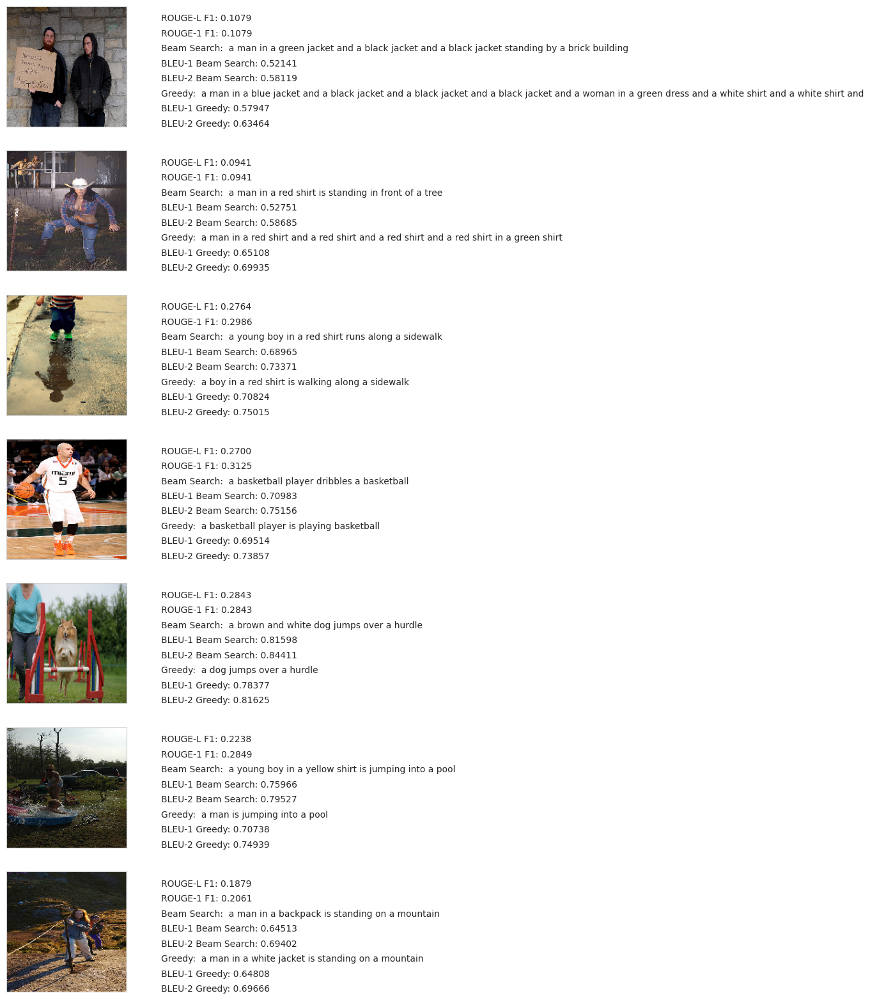

In [76]:
# Install rouge library if not already installed
!pip install rouge

from rouge import Rouge

def load_flickr8k_captions(captions_file):
    reference_caption_dict = {}
    with open(captions_file, 'r') as f:
        # Skip the header line
        next(f)
        for line in f:
            parts = line.strip().split(',', 1)  # Split only on the first comma
            if len(parts) < 2:
                continue  # Skip lines that do not have an image ID and a caption
            
            image_id = parts[0].strip()  # Get image file name
            caption = parts[1].strip()  # Get the caption
            
            # Append the caption to the list of captions for the image
            if image_id not in reference_caption_dict:
                reference_caption_dict[image_id] = []
            reference_caption_dict[image_id].append(caption)

    return reference_caption_dict

def evaluate_rouge(reference_captions, generated_caption):
    """
    Evaluate ROUGE scores between reference captions and a generated caption.

    Parameters:
        reference_captions (list of str): List of reference captions.
        generated_caption (str): Generated caption.

    Returns:
        dict: ROUGE scores.
    """
    rouge = Rouge()

    # Ensure we have a list of reference captions
    if isinstance(reference_captions, str):
        reference_captions = [reference_captions]

    # Calculate ROUGE scores
    scores = rouge.get_scores([generated_caption] * len(reference_captions), reference_captions, avg=True)

    return scores

# Load reference captions for Flickr8k
captions_file = '/kaggle/input/flickr8k/captions.txt'
reference_caption_dict = load_flickr8k_captions(captions_file)

# Function to evaluate ROUGE for a single image
def evaluate_rouge_for_image(image_id, generated_caption):
    reference_captions = reference_caption_dict.get(image_id, [])
    if not reference_captions:
        print(f"No reference captions found for {image_id}.")
        return None
    
    rouge_scores = evaluate_rouge(reference_captions, generated_caption)
    return rouge_scores

# Evaluate ROUGE for all test images
rouge_scores_all = {}
for image_id in test_image_features.keys():
    generated_caption = generated_captions[image_id]
    rouge_scores = evaluate_rouge_for_image(image_id, generated_caption)
    if rouge_scores:
        rouge_scores_all[image_id] = rouge_scores

# Calculate average ROUGE scores across all test images
avg_rouge_scores = {
    'rouge-1': {'f': 0, 'p': 0, 'r': 0},
    'rouge-2': {'f': 0, 'p': 0, 'r': 0},
    'rouge-l': {'f': 0, 'p': 0, 'r': 0}
}

for scores in rouge_scores_all.values():
    for metric in avg_rouge_scores.keys():
        for score_type in avg_rouge_scores[metric].keys():
            avg_rouge_scores[metric][score_type] += scores[metric][score_type]

num_images = len(rouge_scores_all)
for metric in avg_rouge_scores.keys():
    for score_type in avg_rouge_scores[metric].keys():
        avg_rouge_scores[metric][score_type] /= num_images

print("Average ROUGE Scores across all test images:")
print(avg_rouge_scores)

# Visualization function to include ROUGE scores
def visualization_with_rouge(data, greedy_caps, beamS_generator, evaluator, num_of_images):
    keys = list(data.keys())
    images = [np.random.choice(keys) for i in range(num_of_images)]
    
    count = 1
    fig = plt.figure(figsize=(6,20))    
    for filename in images:
        actual_cap = data[filename]
        actual_cap = [x.replace("start ", "") for x in actual_cap]
        actual_cap = [x.replace(" end", "") for x in actual_cap]
    
        greedy_cap = greedy_caps[filename]
        beamS_cap = beamS_generator(test_image_features[filename])
        
        caps_with_score = evaluator(actual_cap, [greedy_cap]*(len(actual_cap)), [beamS_cap]*(len(actual_cap)))
        
        # Add ROUGE scores
        rouge_scores = evaluate_rouge_for_image(filename, greedy_cap)
        if rouge_scores:
            rouge_1_f = rouge_scores['rouge-1']['f']
            rouge_l_f = rouge_scores['rouge-l']['f']
            caps_with_score.append(f"ROUGE-1 F1: {rouge_1_f:.4f}")
            caps_with_score.append(f"ROUGE-L F1: {rouge_l_f:.4f}")
    
        image_load = load_img(images_directory+filename, target_size=(199,199,3))
        ax = fig.add_subplot(num_of_images,2,count,xticks=[],yticks=[])
        ax.imshow(image_load)
        count += 1

        ax = fig.add_subplot(num_of_images,2,count)
        plt.axis('off')
        ax.plot()
        ax.set_xlim(0,1)
        ax.set_ylim(0,len(caps_with_score))
        for i, text in enumerate(caps_with_score):
            ax.text(0,i,text,fontsize=10)
        count += 1
    plt.show()

# Use the updated visualization function
visualization_with_rouge(test_actual_captions, generated_captions, beam_search_generator, BLEU_score, 7)

In [77]:
from rouge import Rouge
from tqdm import tqdm

def evaluate_rouge(reference_captions, generated_caption):
    """
    Evaluate ROUGE scores between reference captions and a generated caption.
    
    Parameters:
        reference_captions (list of str): List of reference captions.
        generated_caption (str): Generated caption.
    
    Returns:
        dict: ROUGE scores.
    """
    rouge = Rouge()
    scores = rouge.get_scores([generated_caption] * len(reference_captions), reference_captions, avg=True)
    return scores

def calculate_rouge_scores_for_dataset(test_image_features, reference_caption_dict, generator_function):
    """
    Calculate ROUGE scores for the entire dataset.
    
    Parameters:
        test_image_features (dict): Dictionary of image features for test set.
        reference_caption_dict (dict): Dictionary of reference captions.
        generator_function (function): Function to generate captions (e.g., greedy_generator or beam_search_generator).
    
    Returns:
        dict: Average ROUGE scores for the entire dataset.
    """
    rouge_scores_sum = {'rouge-1': {'f': 0, 'p': 0, 'r': 0},
                        'rouge-2': {'f': 0, 'p': 0, 'r': 0},
                        'rouge-l': {'f': 0, 'p': 0, 'r': 0}}
    count = 0

    for image_id, image_features in tqdm(test_image_features.items(), desc="Calculating ROUGE scores"):
        if image_id in reference_caption_dict:
            reference_captions = reference_caption_dict[image_id]
            generated_caption = generator_function(image_features)
            
            try:
                scores = evaluate_rouge(reference_captions, generated_caption)
                for metric in rouge_scores_sum.keys():
                    for score_type in rouge_scores_sum[metric].keys():
                        rouge_scores_sum[metric][score_type] += scores[metric][score_type]
                count += 1
            except Exception as e:
                print(f"Error processing image {image_id}: {e}")
    
    # Calculate average scores
    avg_rouge_scores = {metric: {score_type: score / count 
                                 for score_type, score in metric_scores.items()}
                        for metric, metric_scores in rouge_scores_sum.items()}
    
    return avg_rouge_scores

# Calculate ROUGE scores for the entire dataset using greedy generator
greedy_rouge_scores = calculate_rouge_scores_for_dataset(test_image_features, reference_caption_dict, greedy_generator)

print("Average ROUGE Scores (Greedy Generator):")
print(greedy_rouge_scores)

# Calculate ROUGE scores for the entire dataset using beam search generator
beam_search_rouge_scores = calculate_rouge_scores_for_dataset(test_image_features, reference_caption_dict, beam_search_generator)

print("\nAverage ROUGE Scores (Beam Search Generator):")
print(beam_search_rouge_scores)

Calculating ROUGE scores: 100%|██████████| 122/122 [01:30<00:00,  1.35it/s]


Average ROUGE Scores (Greedy Generator):
{'rouge-1': {'f': 0.28656902376102805, 'p': 0.3377495910282796, 'r': 0.2646697463247828}, 'rouge-2': {'f': 0.08046081276878361, 'p': 0.08911457167604699, 'r': 0.07983078515215701}, 'rouge-l': {'f': 0.26071117475687494, 'p': 0.3057005289792174, 'r': 0.2417577370470304}}


Calculating ROUGE scores: 100%|██████████| 122/122 [12:01<00:00,  5.91s/it]


Average ROUGE Scores (Beam Search Generator):
{'rouge-1': {'f': 0.2867910439211308, 'p': 0.33391228079752683, 'r': 0.2695610240290454}, 'rouge-2': {'f': 0.08290258772854209, 'p': 0.09347715808781375, 'r': 0.08184144827390726}, 'rouge-l': {'f': 0.2614561818125305, 'p': 0.30285358994375383, 'r': 0.2466008155671119}}


In [78]:
from nltk.translate.bleu_score import corpus_bleu
from tqdm import tqdm

def calculate_corpus_bleu(reference_captions, generated_captions, weights=(0.25, 0.25, 0.25, 0.25)):
    """
    Calculate corpus BLEU score for the entire dataset.
    
    :param reference_captions: Dictionary of image_id to list of reference captions
    :param generated_captions: Dictionary of image_id to generated caption
    :param weights: Weights for unigrams, bigrams, trigrams, and fourgrams
    :return: Corpus BLEU score
    """
    references = []
    hypotheses = []
    
    for image_id, gen_caption in tqdm(generated_captions.items(), desc="Processing captions"):
        if image_id in reference_captions:
            references.append([caption.split() for caption in reference_captions[image_id]])
            hypotheses.append(gen_caption.split())
    
    return corpus_bleu(references, hypotheses, weights=weights)

# Calculate BLEU scores
bleu1 = calculate_corpus_bleu(reference_caption_dict, generated_captions, weights=(1, 0, 0, 0))
bleu2 = calculate_corpus_bleu(reference_caption_dict, generated_captions, weights=(0.5, 0.5, 0, 0))
bleu3 = calculate_corpus_bleu(reference_caption_dict, generated_captions, weights=(0.33, 0.33, 0.33, 0))
bleu4 = calculate_corpus_bleu(reference_caption_dict, generated_captions)

print(f"BLEU-1: {bleu1:.4f}")
print(f"BLEU-2: {bleu2:.4f}")
print(f"BLEU-3: {bleu3:.4f}")
print(f"BLEU-4: {bleu4:.4f}")

Processing captions: 100%|██████████| 122/122 [00:00<00:00, 144794.87it/s]

BLEU-1: 0.5059
BLEU-2: 0.3351
BLEU-3: 0.2083
BLEU-4: 0.1216
